In [1]:
# Import the required libraries
import pandas as pd
import seaborn as sns
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from category_encoders.ordinal import OrdinalEncoder
import umap.umap_ as umap
import hdbscan



In [3]:
# Load the data

data = pd.read_csv(r'F:\new\IUBH\Courses\20-mechine_learning_unsup\mental-heath-in-tech-2016_20161114.csv')
data.head(5)

,Are you self-employed?,How many employees does your company or organization have?,Is your employer primarily a tech company/organization?,Is your primary role within your company related to tech/IT?,Does your employer provide mental health benefits as part of healthcare coverage?,Do you know the options for mental health care available under your employer-provided coverage?,"Has your employer ever formally discussed mental health (for example, as part of a wellness campaign or other official communication)?",Does your employer offer resources to learn more about mental health concerns and options for seeking help?,Is your anonymity protected if you choose to take advantage of mental health or substance abuse treatment resources provided by your employer?,"If a mental health issue prompted you to request a medical leave from work, asking for that leave would be:",...,"If you have a mental health issue, do you feel that it interferes with your work when being treated effectively?","If you have a mental health issue, do you feel that it interferes with your work when NOT being treated effectively?",What is your age?,What is your gender?,What country do you live in?,What US state or territory do you live in?,What country do you work in?,What US state or territory do you work in?,Which of the following best describes your work position?,Do you work remotely?
0,0,26-100,1.0,NaN,Not eligible for coverage / N/A,NaN,No,No,I don't know,Very easy,...,Not applicable to me,Not applicable to me,39,Male,United Kingdom,NaN,United Kingdom,NaN,Back-end Developer,Sometimes
1,0,6-25,1.0,NaN,No,Yes,Yes,Yes,Yes,Somewhat easy,...,Rarely,Sometimes,29,male,United States of America,Illinois,United States of America,Illinois,Back-end Developer|Front-end Developer,Never
2,0,6-25,1.0,NaN,No,NaN,No,No,I don't know,Neither easy nor difficult,...,Not applicable to me,Not applicable to me,38,Male,United Kingdom,NaN,United Kingdom,NaN,Back-end Developer,Always
3,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,Sometimes,Sometimes,43,male,United Kingdom,NaN,United Kingdom,NaN,Supervisor/Team Lead,Sometimes
4,0,6-25,0.0,1.0,Yes,Yes,No,No,No,Neither easy nor difficult,...,Sometimes,Sometimes,43,Female,United States of America,Illinois,United States of America,Illinois,Executive Leadership|Supervisor/Team Lead|Dev ...,Sometimes


In [88]:
data.shape

(1433, 63)

In [4]:
# lets Check for null values

s=data.isnull().sum()/1433
mask=s.mask(s<0.75).dropna().index
data=data.drop(list(mask),axis=1)


In [5]:
r=data.isnull().sum(axis=1)/63
mask=r.mask(r<0.5).dropna().index
data=data.drop(list(mask),axis=0)

In [6]:
#As you can see we are rid of most NA values and have a clean data set
data.isnull().sum()

Are you self-employed?                                                                                                                                                                0
How many employees does your company or organization have?                                                                                                                          283
Is your employer primarily a tech company/organization?                                                                                                                             283
Does your employer provide mental health benefits as part of healthcare coverage?                                                                                                   283
Do you know the options for mental health care available under your employer-provided coverage?                                                                                     416
Has your employer ever formally discussed mental health (for example, as part of

# PreProcessing

In [7]:
# Next, we substitute the mode of each column for the remaining NA values, where mode stands for the most often occurring numerical number.
fill_mode = lambda col: col.fillna(col.mode())
data=data.apply(fill_mode, axis=0)



In [8]:
# It will save time in the long run if we shorten the names of two crucial columns first.

data.rename(columns={'What is your age?':'Age','What is your gender?':'Gender'},inplace=True)

#The gender column appears to have a large number of unique characteristics, 
# which could cause problems when encoding features and introduce bias into our model.

data['Gender'] = data['Gender'].replace([
    'male', 'Male ', 'M', 'm', 'man', 'Cis male',
    'Male.', 'Male (cis)', 'Man', 'Sex is male',
    'cis male', 'Malr', 'Dude', "I'm a man why didn't you make this a drop down question. You should of asked sex? And I would of answered yes please. Seriously how much text can this take? ",
    'mail', 'M|', 'male ', 'Cis Male', 'Male (trans, FtM)',
    'cisdude', 'cis man', 'MALE'], 'Male')
data['Gender'] = data['Gender'].replace([
    'female', 'I identify as female.', 'female ',
    'Female assigned at birth ', 'F', 'Woman', 'fm', 'f',
    'Cis female', 'Transitioned, M2F', 'Female or Multi-Gender Femme',
    'Female ', 'woman', 'female/woman', 'Cisgender Female', 
    'mtf', 'fem', 'Female (props for making this a freeform field, though)',
    ' Female', 'Cis-woman', 'AFAB', 'Transgender woman',
    'Cis female '], 'Female')
data['Gender'] = data['Gender'].replace([
    'Bigender', 'non-binary,', 'Genderfluid (born female)',
    'Other/Transfeminine', 'Androgynous', 'male 9:1 female, roughly',
    'nb masculine', 'genderqueer', 'Human', 'Genderfluid',
    'Enby', 'genderqueer woman', 'Queer', 'Agender', 'Fluid',
    'Genderflux demi-girl', 'female-bodied; no feelings about gender',
    'non-binary', 'Male/genderqueer', 'Nonbinary', 'Other', 'none of your business',
    'Unicorn', 'human', 'Genderqueer'], 'Other')



<AxesSubplot:xlabel='Age', ylabel='Count'>

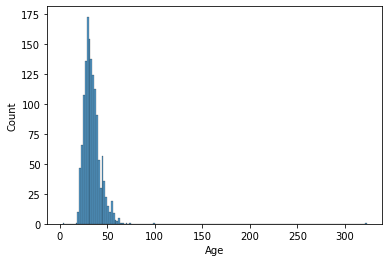

In [9]:
# we will now check the distribution of the Age

sns.histplot(data=data.Age)


In [10]:

# USE scipy.stats.zscore() TO REMOVE OUTLIERS FROM A DATAFRAME

from scipy.stats import zscore
import numpy as np

def outlier_detection(df):
    z_scores = zscore(df)
    

    abs_z_scores = np.abs(z_scores)
    filtered_entries = (abs_z_scores < 3)
    result = df.mask((abs_z_scores < 3)).dropna()
    
    return list(result)
outliers=outlier_detection(data.Age)    





<AxesSubplot:xlabel='Age', ylabel='Count'>

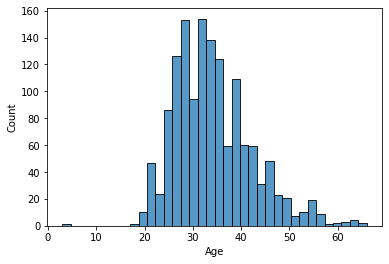

In [11]:
cleaned_data = data.loc[~data.Age.isin(outliers)]
sns.histplot(cleaned_data.Age)
#After weeding out the anomalies, the Age column seems much more consistent.

In [12]:
# For the sake of doing PCA and cluster analysis, we will now utilize Ordinal encoder to convert category information into numeric values.


encoded_data = cleaned_data
Ordinal = OrdinalEncoder()
encoded_data = Ordinal.fit_transform(cleaned_data.drop(['Age'], axis=1))

In [13]:
#Age was not included in the initial data encoding because it was already a numerical column type, but we bring it back in after the fact.
#Only categorical features need to be encoded.

encoded_data['Age'] = cleaned_data.Age
encoded_data=encoded_data.fillna(0)
encoded_data.head()

,Are you self-employed?,How many employees does your company or organization have?,Is your employer primarily a tech company/organization?,Does your employer provide mental health benefits as part of healthcare coverage?,Do you know the options for mental health care available under your employer-provided coverage?,"Has your employer ever formally discussed mental health (for example, as part of a wellness campaign or other official communication)?",Does your employer offer resources to learn more about mental health concerns and options for seeking help?,Is your anonymity protected if you choose to take advantage of mental health or substance abuse treatment resources provided by your employer?,"If a mental health issue prompted you to request a medical leave from work, asking for that leave would be:",Do you think that discussing a mental health disorder with your employer would have negative consequences?,...,"If you have a mental health issue, do you feel that it interferes with your work when being treated effectively?","If you have a mental health issue, do you feel that it interferes with your work when NOT being treated effectively?",Gender,What country do you live in?,What US state or territory do you live in?,What country do you work in?,What US state or territory do you work in?,Which of the following best describes your work position?,Do you work remotely?,Age
0,0,1,1.0,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,39
1,0,2,1.0,2,2,2,2,2,2,1,...,2,2,1,2,2,2,2,2,2,29
2,0,2,1.0,2,3,1,1,1,3,2,...,1,1,1,1,3,1,3,1,3,38
3,1,3,0.0,3,3,3,3,3,4,3,...,3,2,1,1,3,1,3,3,1,43
4,0,2,0.0,4,2,1,1,4,3,4,...,3,2,2,2,2,2,2,4,1,43


# Feature Selection




#### Correlation



Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

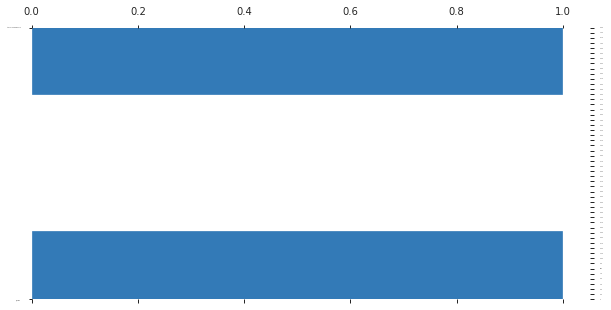

In [14]:
#the ProfileReport library gives us a lot of knowledge about the data set.
ProfileReport(encoded_data, title="Pandas Profiling Report", explorative=True)

it seems There is a very high correlation between ' Have you been diagnosed with a mental health condition by a medical professional? '  And  ' Have you ever sought treatment for a mental health issue from a mental health professional? ' and 
' Have you ever sought treatment for a mental health issue from a mental health professional? '  And  ' Have you had a mental disorder in the past '
so Our target variable here is the ' Have you ever sought treatment for a mental health issue from a mental health professional? ' 

In [15]:
# I'll shorten the complex expression by renaming the dependent variable "treatment."

encoded_data.rename(columns={'Have you ever sought treatment for a mental health issue from a mental health professional?': 'treatment' } , inplace=True)

# The relationships between the target variable and the other variables will now be examined.

correlations = encoded_data.corr().unstack().sort_values(ascending=False) # Building correlation matrix
correlations = pd.DataFrame(correlations).reset_index() # Converting to dataframe
correlations.columns = ['col1', 'col2', 'correlation'] # Labeling the columns for easier processing
correlations.query("col1 == 'treatment' & col2 != 'treatment'") # Filtering by variable treatment



,col1,col2,correlation
117,treatment,"If you have a mental health issue, do you feel...",0.550314
134,treatment,"If you have a mental health issue, do you feel...",0.518721
220,treatment,Do you currently have a mental health disorder?,0.298613
233,treatment,"If so, what condition(s) were you diagnosed with?",0.276811
260,treatment,Do you have a family history of mental illness?,0.239314
270,treatment,"If yes, what condition(s) have you been diagno...",0.218074
276,treatment,Gender,0.211894
316,treatment,Do you feel that being identified as a person ...,0.162862
429,treatment,Do you think that discussing a mental health d...,0.123439
518,treatment,Do you think that team members/co-workers woul...,0.102389


In [16]:
# we subset just the top 12 features 

head = correlations.query("col1 == 'treatment' & col2 != 'treatment'")
head = head.head(12)
head




,col1,col2,correlation
117,treatment,"If you have a mental health issue, do you feel...",0.550314
134,treatment,"If you have a mental health issue, do you feel...",0.518721
220,treatment,Do you currently have a mental health disorder?,0.298613
233,treatment,"If so, what condition(s) were you diagnosed with?",0.276811
260,treatment,Do you have a family history of mental illness?,0.239314
270,treatment,"If yes, what condition(s) have you been diagno...",0.218074
276,treatment,Gender,0.211894
316,treatment,Do you feel that being identified as a person ...,0.162862
429,treatment,Do you think that discussing a mental health d...,0.123439
518,treatment,Do you think that team members/co-workers woul...,0.102389


In [17]:
# List of top 12 features printed as list this time as i couldnt see the full names of the features in a df view

top_12 = head['col2'].tolist()
top_12

['If you have a mental health issue, do you feel that it interferes with your work when NOT being treated effectively?',
 'If you have a mental health issue, do you feel that it interferes with your work when being treated effectively?',
 'Do you currently have a mental health disorder?',
 'If so, what condition(s) were you diagnosed with?',
 'Do you have a family history of mental illness?',
 'If yes, what condition(s) have you been diagnosed with?',
 'Gender',
 'Do you feel that being identified as a person with a mental health issue would hurt your career?',
 'Do you think that discussing a mental health disorder with your employer would have negative consequences?',
 'Do you think that team members/co-workers would view you more negatively if they knew you suffered from a mental health issue?',
 'Have you heard of or observed negative consequences for co-workers who have been open about mental health issues in your workplace?',
 'Do you think that discussing a physical health issue

In [18]:
# These are features with the most correlation in other words that have the most impact on our prediction
selected_features = ['Have you had a mental health disorder in the past?',
 'If you have a mental health issue, do you feel that it interferes with your work when NOT being treated effectively?',
 'Do you currently have a mental health disorder?',
 'If you have a mental health issue, do you feel that it interferes with your work when being treated effectively?',
 'Gender',
 'What country do you work in?',
 'Have you been diagnosed with a mental health condition by a medical professional?',
 'Do you feel that being identified as a person with a mental health issue would hurt your career?',
  'Were you aware of the options for mental health care provided by your previous employers?',
  'Do you have a family history of mental illness?',
  'Have you observed or experienced an unsupportive or badly handled response to a mental health issue in your current or previous workplace?']


# We now subset the select features on the encoded data and rename the coulumns for easier processing

selected_features_1 = encoded_data[selected_features]
selected_features_1.rename(columns={'Have you had a mental health disorder in the past?':'past_hist','If you have a mental health issue, do you feel that it interferes with your work when NOT being treated effectively?':'not_effectively_treated','Do you currently have a mental health disorder?':'current_status',
'If you have a mental health issue, do you feel that it interferes with your work when being treated effectively?':'effectively_treated','What country do you work in?':'country','Have you been diagnosed with a mental health condition by a medical professional?':'diagnosis',
'Do you feel that being identified as a person with a mental health issue would hurt your career?':'career_effect','Were you aware of the options for mental health care provided by your previous employers?':'awareness_program','Do you have a family history of mental illness?':'family_hist',
'Have you observed or experienced an unsupportive or badly handled response to a mental health issue in your current or previous workplace?':'obs_consequnces'},inplace=True)
selected_features_1['treatment'] = encoded_data.treatment
selected_features_1

f:\new\Python38\lib\site-packages\pandas\core\frame.py:5039: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(
C:\Users\f_pc\AppData\Local\Temp\ipykernel_44584\1673536526.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selected_features_1['treatment'] = encoded_data.treatment


,past_hist,not_effectively_treated,current_status,effectively_treated,Gender,country,diagnosis,career_effect,awareness_program,family_hist,obs_consequnces,treatment
0,1,1,1,1,1,1,1,1,1,1,1,0
1,1,2,2,2,1,2,1,2,2,2,1,1
2,2,1,1,1,1,1,2,1,1,1,2,1
3,1,2,2,3,1,1,1,3,1,1,1,1
4,1,2,2,3,2,2,1,3,1,2,3,1
...,...,...,...,...,...,...,...,...,...,...,...,...
1428,3,1,1,1,2,2,2,1,2,2,2,1
1429,3,3,1,3,1,38,1,4,5,2,2,0
1430,1,2,3,2,1,2,1,5,2,2,4,1
1431,2,3,2,3,2,2,1,2,1,2,3,0


## Normalization

In [19]:
# if you dont standardize you observe that these values are spread out far apart, which isnt ideal.

Scaler = StandardScaler()
scaled = Scaler.fit_transform(selected_features_1)



# U MAP

Shape: 1425 rows, 2 columns (dimensions)


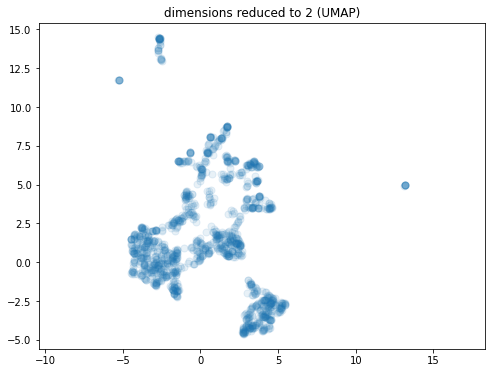

In [20]:
# UMAP is a dimension reduction technique such as PCA i would like to try these to check for clusters and then proceed with PCA also.
reducer = umap.UMAP()  
embedding = reducer.fit_transform(scaled) 
cmap = sns.diverging_palette(220, 10, as_cmap=True)
print(f'Shape: {embedding.shape[0]} rows, {embedding.shape[1]} columns (dimensions)')  

# defining a function to plot the cluster in 2D
def plotter_2d(title: str, cluster_labels=None, legend=False):
    plt.figure(figsize=(8, 6))
    sc = plt.scatter(embedding[:, 0], embedding[:, 1], c=cluster_labels,
                     s=50, alpha=.1, cmap=cmap)  
    plt.gca().set_aspect('equal', 'datalim')
    if legend: 
        legend = plt.legend(*sc.legend_elements(alpha=.9), 
                            loc='best', title='clusters')
    plt.grid(False)
    plt.title(title)
    plt.show()


plotter_2d('dimensions reduced to 2 (UMAP)')   

#### The preceding graph leads us to the conclusion that we do, in fact, have clusters.

## HDBSCAN 

* Unlike other clustering algorithms , HDBSCAN does not need extensive hyper parameter tuning. In this case the cluster size and number of neighbors for a minimal cluster are sufficient


In [62]:
pca = PCA(n_components = 3)
pca_data = pca.fit_transform(scaled)
percentage_var_explained = pca.explained_variance_ / np.sum(pca.explained_variance_)
cum_var_explained = np.cumsum(percentage_var_explained)
print(f'\nCummulative explained variance, 3 principal components: \n{cum_var_explained}\n')
pca_df = pd.DataFrame(pca.transform(scaled), columns=(['PC1', 'PC2', 'PC3']))
clusterer = hdbscan.HDBSCAN(min_cluster_size=20, min_samples=35, 
                            metric='manhattan', cluster_selection_method='leaf',
                            gen_min_span_tree=True)
clusterer.fit(pca_df)
print(f"DBCV score {clusterer.relative_validity_}")


Cummulative explained variance, 3 principal components: 
[0.63335472 0.81866463 1.        ]

DBCV score 0.1691749313981959


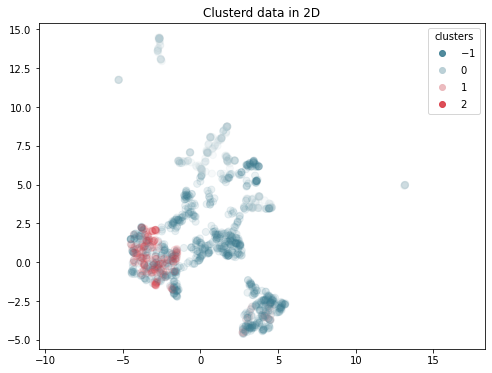

In [64]:
# we use the function we created above to plot the clusters in 2D
plotter_2d('Clusterd data in 2D', clusterer.labels_, legend=True)

In [55]:
# appending cluster labels to the original dataframe, aggregating the data
selected_features_1['HDBSCAN_cluster'] = clusterer.labels_.tolist()
selected_features_1.groupby('HDBSCAN_cluster').mean().T

C:\Users\f_pc\AppData\Local\Temp\ipykernel_44584\649655565.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selected_features_1['HDBSCAN_cluster'] = clusterer.labels_.tolist()


HDBSCAN_cluster,-1,0,1,2
past_hist,1.663409,2.867159,1.029412,1.100503
not_effectively_treated,2.320304,1.055351,2.735294,2.743719
current_status,2.035831,1.070111,2.088235,2.080402
effectively_treated,2.371336,1.033210,2.735294,2.698492
Gender,1.398480,1.014760,2.000000,1.010050
country,6.349620,2.734317,2.029412,2.286432
diagnosis,1.477742,2.000000,1.000000,1.000000
career_effect,2.426710,1.789668,1.882353,2.100503
awareness_program,2.251900,2.202952,2.352941,2.145729
family_hist,1.947883,1.405904,2.058824,1.969849


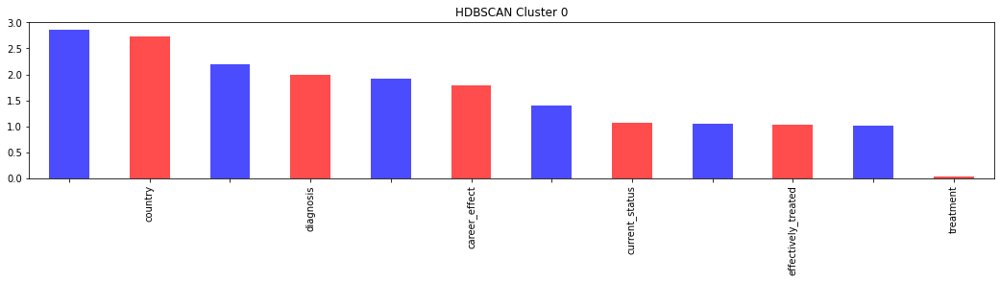

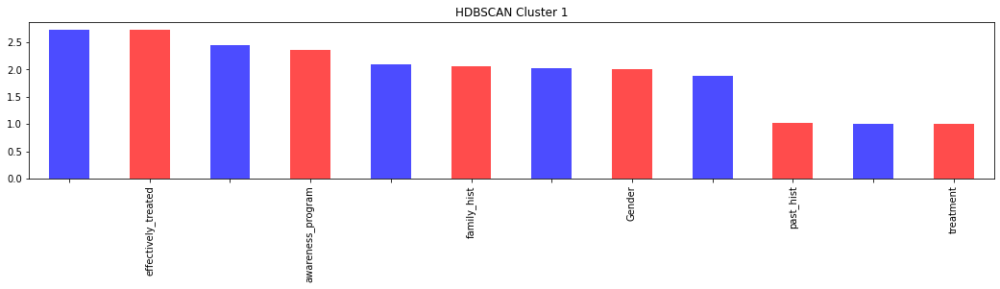

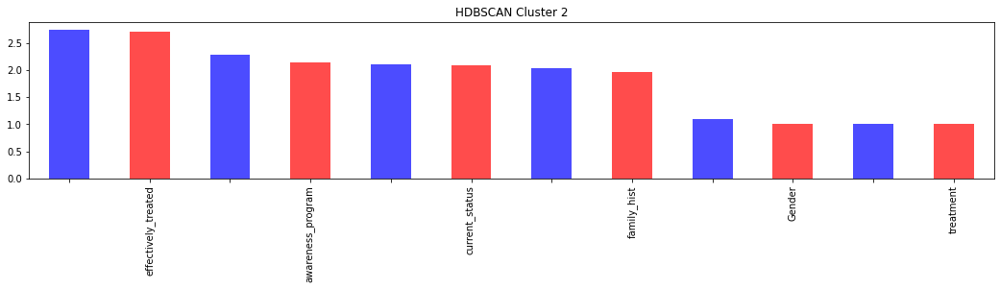

In [56]:
# get visual cluster by cluster 
for i in range(3): 
    plot = selected_features_1[selected_features_1['HDBSCAN_cluster'] == i].mean()[[col for col in selected_features_1.columns.tolist() 
                                        if col not in ['HDBSCAN_cluster']]].sort_values(
        ascending=False).plot.bar(figsize=(18,3), color=['blue','red'], alpha=.7)
    plt.title(f'HDBSCAN Cluster {i}')
    plt.setp(plot.get_xticklabels()[::2], visible=False)
    plt.grid(False)
    plt.show()

In [57]:
# print top-10 features per cluster
for i in range(3): 
    a = selected_features_1[selected_features_1['HDBSCAN_cluster'] == i].mean()[[col for col in selected_features_1.columns.tolist() 
                            if col not in ['HDBSCAN_cluster']]].sort_values(ascending=False)
    print(f'***HDBSCAN Cluster {i} ***', '\n'+30*'=', '\n', a[0:10], '\n'+30*'=')  

***HDBSCAN Cluster 0 *** 
 past_hist                  2.867159
country                    2.734317
awareness_program          2.202952
diagnosis                  2.000000
obs_consequnces            1.915129
career_effect              1.789668
family_hist                1.405904
current_status             1.070111
not_effectively_treated    1.055351
effectively_treated        1.033210
dtype: float64 
***HDBSCAN Cluster 1 *** 
 not_effectively_treated    2.735294
effectively_treated        2.735294
obs_consequnces            2.441176
awareness_program          2.352941
current_status             2.088235
family_hist                2.058824
country                    2.029412
Gender                     2.000000
career_effect              1.882353
past_hist                  1.029412
dtype: float64 
***HDBSCAN Cluster 2 *** 
 not_effectively_treated    2.743719
effectively_treated        2.698492
country                    2.286432
awareness_program          2.145729
career_effect          